# DCGAN

### Packages and Modules

In [1]:
import numpy as np
import os
import time
import random
import matplotlib.pyplot as plt
from PIL import Image
from tqdm.notebook import tqdm

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.layers import Input, Flatten, Dropout
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Reshape
from tensorflow.keras.layers import Conv2DTranspose, LeakyReLU, Dense
from tensorflow.keras.layers import BatchNormalization, Activation
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import img_to_array, array_to_img, load_img

In [2]:
%matplotlib inline

In [3]:
import warnings
warnings.filterwarnings('ignore')

### Load data and preprocessing

In [4]:
# get data files
def get_files(data_dir):
    filenames = os.listdir(data_dir)
    images = [os.path.join(data_dir, fname) for fname in filenames]
    return images

data1 = get_files(r'C:\Users\user\MY_DL\GAN\shirt_data\Jacket')
data2 = get_files(r'C:\Users\user\MY_DL\GAN\shirt_data\Polo shirt')
data3 = get_files(r'C:\Users\user\MY_DL\GAN\shirt_data\Shirt')
data4 = get_files(r'C:\Users\user\MY_DL\GAN\shirt_data\Tank top')
data5 = get_files(r'C:\Users\user\MY_DL\GAN\shirt_data\T-shirt')
data6 = get_files(r'C:\Users\user\MY_DL\GAN\shirt_data\Warm clothes')
# combine datasets
dataset = data1+data2+data3+data4+data5+data6
# shuffle datasets
random.shuffle(dataset)

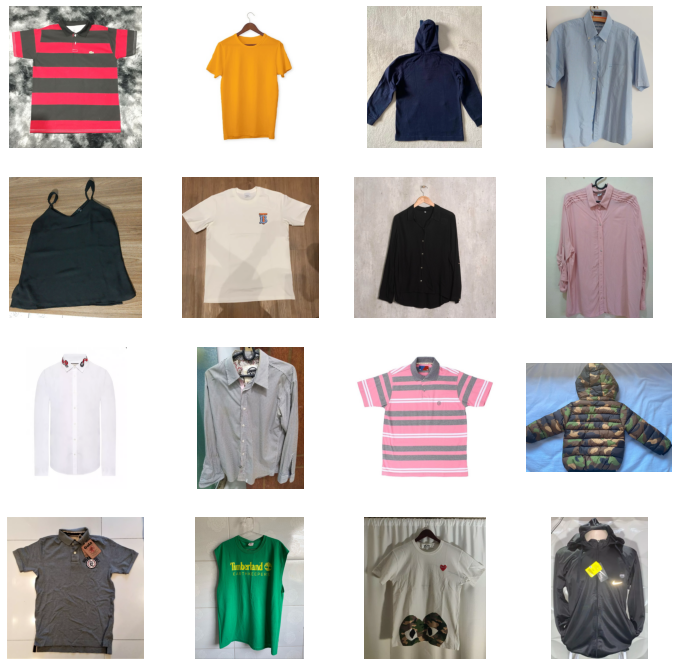

In [5]:
# show image
def show_image(n_samples, data_set):
    n = int(np.ceil(np.sqrt(n_samples)))
    plt.figure(figsize=(3*n,3*n))
    for i in range(n_samples):
        plt.subplot(n,n,i+1)
        plt.imshow(Image.open(data_set[i]))
        plt.axis('off')
    plt.show()
    
show_image(16, dataset)

In [6]:
# resize image to 64x64x3
target_size = (64,64,3)

# load images
def load_data(files):
    data_list = []
    for file in files:
        img = load_img(file, target_size=target_size)
        img = img_to_array(img)
        data_list.append(img)
    data_list = np.array(data_list).astype('float32')
    return data_list

dataset = load_data(dataset)

In [7]:
# data preprocessing to [-1,1] for tanh in generator model
def preprocess(data_set):
    X = (data_set-127.5)/127.5
    return X

dataset = preprocess(dataset)

### Define Models

In [8]:
# define generator model
def generator_model(latent_dim):
    model = Sequential()
    # 8x8x128 feature map
    model.add(Dense(8*8*128, input_shape=[latent_dim,]))
    model.add(LeakyReLU(0.2))
    model.add(Reshape([8,8,128]))
    
    # upsampling to 16x16x128
    model.add(Conv2DTranspose(128, (4,4), strides=2, padding='same'))
    model.add(LeakyReLU(0.2))
    
    # upsampling to 32x32x128
    model.add(Conv2DTranspose(128, (4,4), strides=2, padding='same'))
    model.add(LeakyReLU(0.2))
    
    # upsampling to 64x64x128
    model.add(Conv2DTranspose(128, (4,4), strides=2, padding='same'))
    model.add(LeakyReLU(0.2))
    
    # upsampling to 64x64x3
    model.add(Conv2DTranspose(3, (5,5), strides=1, padding='same', activation='tanh'))
    return model

In [9]:
# define discriminator model
def discriminator_model(input_shape=(64,64,3)):
    model = Sequential()
    # downsampling to 32x32x64
    model.add(Conv2D(64, (5,5), strides=2, padding='same', input_shape=input_shape))
    model.add(LeakyReLU(0.2))
    
    # downsampling to 16x16x128
    model.add(Conv2D(128, (5,5), strides=2, padding='same'))
    model.add(LeakyReLU(0.2))
    
    # downsampling to 8x8x256
    model.add(Conv2D(256, (5,5), strides=2, padding='same'))
    model.add(LeakyReLU(0.2))
    
    # downsampling to 4x4x512
    model.add(Conv2D(512, (5,5), strides=2, padding='same'))
    model.add(LeakyReLU(0.2))
    
    # fully connected layer
    model.add(Flatten())
    model.add(Dropout(0.2))
    model.add(Dense(1, activation='sigmoid'))
    
    # set loss function and optimizer
    opt = Adam(learning_rate=0.0002, beta_1=0.5)
    model.compile(loss='binary_crossentropy', optimizer=opt, metrics=['accuracy'])
    
    return model

In [10]:
def gan_model(g_model, d_model):
    # discriminator not trainable
    d_model.trainable = False
    # create model
    model = Sequential()
    # add generator
    model.add(g_model)
    # add discriminator
    model.add(d_model)
    # compile model
    opt = Adam(learning_rate=0.0002, beta_1=0.5)
    model.compile(loss='binary_crossentropy', optimizer=opt)
    return model

### Define functions for training model

In [11]:
# generate latent space
def generate_latent(latent_dim, batch_size):
    # create gaussian distribution noise
    space = tf.random.normal(shape=[batch_size, latent_dim])
    return space

# generate fake samples and labels
def generate_fake_samples(g_model, latent_dim, batch_size):
    # get noise
    noise = generate_latent(latent_dim, batch_size)
    # get fake image through generator model
    fake_image = g_model.predict(noise)
    # create fake label
    fake_label = np.zeros((batch_size,1))
    return fake_image, fake_label

# get real samples and labels
def get_real_samples(batch_images):
    # get real images
    real_image = batch_images
    # create real label
    real_label = np.ones((batch_size,1))
    return real_image, real_label

# show generated images
def plot_generated_images(generated, epoch, every):
    # plot generated images every n epochs
    if epoch%every==0:
        plt.figure(figsize=(12,8))
        for i in range(12):
            # [-1,1] -> [0,1]
            img = (generated[i]+1)/2
            plt.subplot(3,4,i+1)
            plt.imshow(img)
            plt.axis('off')
        plt.show()
    else:
        pass

In [12]:
# hyperparameter setting
batch_size = 32
latent_dim = 100

# create dataset batch
dataset = tf.data.Dataset.from_tensor_slices(dataset).shuffle(100)
dataset = dataset.batch(batch_size, drop_remainder=True).prefetch(1)

### Model training

In [13]:
# load models
generator = generator_model(latent_dim)
discriminator = discriminator_model()
gan = gan_model(generator, discriminator)

In [14]:
# define gan model training
def train_gan(gan, dataset, batch_size, latent_dim, n_epochs, show_image_epoch):
    generator, discriminator = gan.layers
    # set start time
    start_time = time.time()
    # n_epochs 만큼 훈련 진행
    for epoch in tqdm(range(n_epochs)):
        # set start time of each epoch
        initial_epoch_time = time.time()
        # batch마다 훈련 진행
        for X_batch in dataset:
            # step1: real images, label을 얻는다
            X_real, y_real = get_real_samples(X_batch)
            # step2: real samples를 가지고 discriminator을 훈련 and update 진행
            d_loss_real, _ = discriminator.train_on_batch(X_real, y_real)
            # step3: fake samples를 생성
            X_fake, y_fake = generate_fake_samples(generator, latent_dim, batch_size)
            # step4: fake samples로 discriminator model을 훈련 and update 진행
            d_loss_fake, _ = discriminator.train_on_batch(X_fake, y_fake)
            # step5: gan을 훈련하기 위해 노이즈와 라벨 생성
            X_gan = generate_latent(latent_dim, batch_size)
            y_gan = np.ones((batch_size,1))
            # step6: GAN model 훈련 and update 진행
            gan_loss = gan.train_on_batch(X_gan, y_gan)
        # show each epoch and time and losses
        every_epoch_time = time.time()
        epoch_time = every_epoch_time-initial_epoch_time
        print(f'Epoch {epoch+1}/{EPOCH}, time: {epoch_time}s\nloss about real data: {d_loss_real}, loss about fake data: {d_loss_fake}\nloss about GAN: {gan_loss}\n')
        # 생성된 fake images 보여주기
        plot_generated_images(X_fake, epoch+1, show_image_epoch)
    end_time = time.time()
    print(f'Total time for training is {end_time-start_time}s')
    return X_fake

  0%|          | 0/200 [00:00<?, ?it/s]

Epoch 1/200, time: 9.747236251831055s
loss about real data: 0.029217515140771866, loss about fake data: 0.006510593928396702
loss about GAN: 5.324133396148682

Epoch 2/200, time: 6.381227731704712s
loss about real data: 0.059782788157463074, loss about fake data: 0.17973318696022034
loss about GAN: 10.094842910766602

Epoch 3/200, time: 6.402034282684326s
loss about real data: 0.31250619888305664, loss about fake data: 0.0853702649474144
loss about GAN: 2.5939764976501465

Epoch 4/200, time: 6.411075592041016s
loss about real data: 0.6715652942657471, loss about fake data: 0.00288334209471941
loss about GAN: 5.297603607177734

Epoch 5/200, time: 6.460861921310425s
loss about real data: 0.4178432822227478, loss about fake data: 0.4559602737426758
loss about GAN: 3.982199192047119



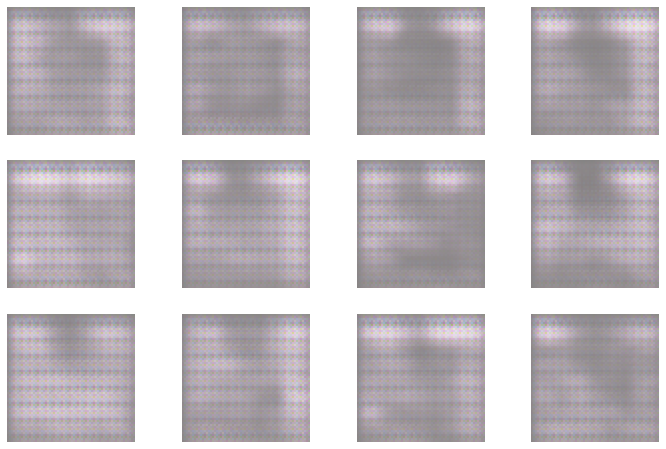

Epoch 6/200, time: 6.243830919265747s
loss about real data: 0.43455633521080017, loss about fake data: 4.29865722253453e-05
loss about GAN: 15.73448657989502

Epoch 7/200, time: 6.278486251831055s
loss about real data: 0.2558804452419281, loss about fake data: 0.04748242348432541
loss about GAN: 3.8397412300109863

Epoch 8/200, time: 6.321837663650513s
loss about real data: 0.08789943903684616, loss about fake data: 0.040275704115629196
loss about GAN: 3.6891584396362305

Epoch 9/200, time: 6.330468416213989s
loss about real data: 0.262606680393219, loss about fake data: 0.4198702871799469
loss about GAN: 3.1601390838623047

Epoch 10/200, time: 6.319272518157959s
loss about real data: 0.5769452452659607, loss about fake data: 0.36057761311531067
loss about GAN: 2.7444159984588623



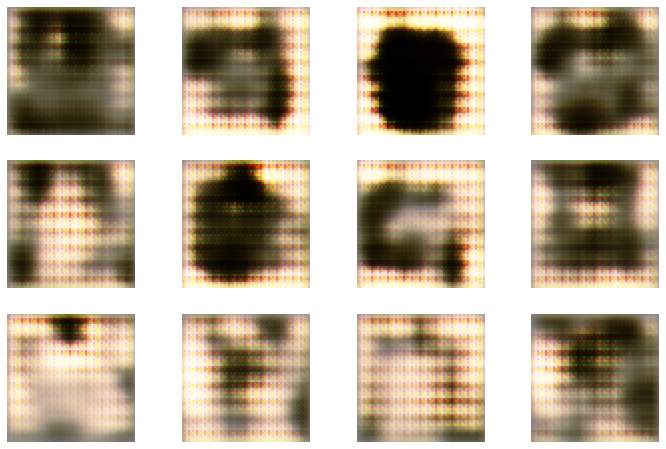

Epoch 11/200, time: 6.497402906417847s
loss about real data: 0.2439097762107849, loss about fake data: 0.03564243018627167
loss about GAN: 3.7873401641845703

Epoch 12/200, time: 6.49777626991272s
loss about real data: 0.06642667949199677, loss about fake data: 0.10282769054174423
loss about GAN: 5.223114490509033

Epoch 13/200, time: 6.557255506515503s
loss about real data: 0.1836484670639038, loss about fake data: 0.48284831643104553
loss about GAN: 5.693355560302734

Epoch 14/200, time: 6.541433334350586s
loss about real data: 0.13854166865348816, loss about fake data: 0.14613640308380127
loss about GAN: 4.155769348144531

Epoch 15/200, time: 6.383089065551758s
loss about real data: 0.16292619705200195, loss about fake data: 0.2019396424293518
loss about GAN: 4.669646263122559



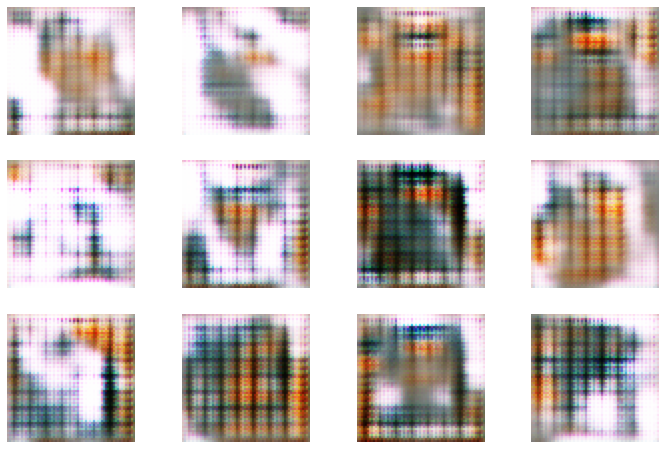

Epoch 16/200, time: 6.483208894729614s
loss about real data: 0.18892523646354675, loss about fake data: 0.14014050364494324
loss about GAN: 3.999040126800537

Epoch 17/200, time: 6.4602439403533936s
loss about real data: 0.31585031747817993, loss about fake data: 0.4023715853691101
loss about GAN: 5.976173400878906

Epoch 18/200, time: 6.31269097328186s
loss about real data: 0.3046590983867645, loss about fake data: 0.08023662865161896
loss about GAN: 4.049525737762451

Epoch 19/200, time: 6.469272136688232s
loss about real data: 0.0656733512878418, loss about fake data: 0.1629011332988739
loss about GAN: 5.895468235015869

Epoch 20/200, time: 6.516494035720825s
loss about real data: 0.0988735631108284, loss about fake data: 0.1384028047323227
loss about GAN: 3.84957218170166



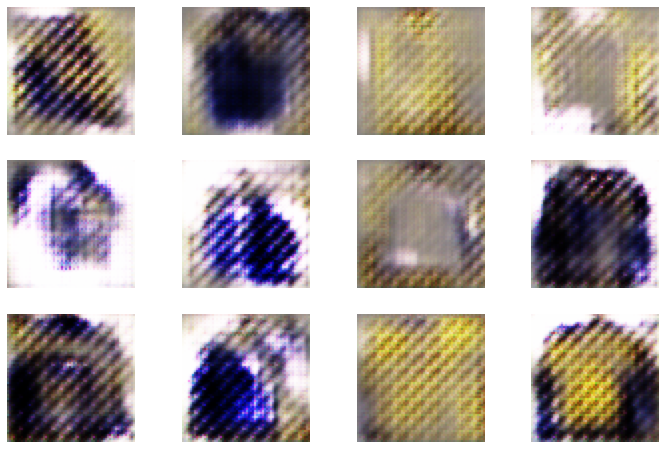

Epoch 21/200, time: 6.33132791519165s
loss about real data: 0.08128630369901657, loss about fake data: 0.0611560232937336
loss about GAN: 4.241556167602539

Epoch 22/200, time: 6.315804719924927s
loss about real data: 0.17465141415596008, loss about fake data: 0.010097377002239227
loss about GAN: 5.020293712615967

Epoch 23/200, time: 6.17406439781189s
loss about real data: 0.3795285224914551, loss about fake data: 0.27917981147766113
loss about GAN: 3.5107667446136475

Epoch 24/200, time: 6.285119533538818s
loss about real data: 0.19221968948841095, loss about fake data: 0.1471807360649109
loss about GAN: 4.367861747741699

Epoch 25/200, time: 6.3957788944244385s
loss about real data: 0.1490079164505005, loss about fake data: 0.04855114221572876
loss about GAN: 5.3285112380981445



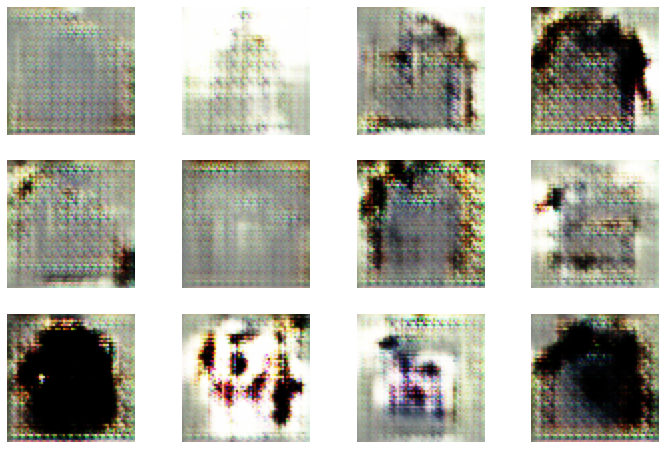

Epoch 26/200, time: 6.297874689102173s
loss about real data: 0.17777130007743835, loss about fake data: 0.06962073594331741
loss about GAN: 4.044610977172852

Epoch 27/200, time: 6.389176368713379s
loss about real data: 0.0868094339966774, loss about fake data: 0.1243419498205185
loss about GAN: 4.908240795135498

Epoch 28/200, time: 6.502065181732178s
loss about real data: 0.09050989151000977, loss about fake data: 0.17400327324867249
loss about GAN: 4.994978904724121

Epoch 29/200, time: 6.343665838241577s
loss about real data: 0.425985187292099, loss about fake data: 0.042797334492206573
loss about GAN: 5.683659553527832

Epoch 30/200, time: 6.47288703918457s
loss about real data: 0.19046857953071594, loss about fake data: 0.09922720491886139
loss about GAN: 4.399023532867432



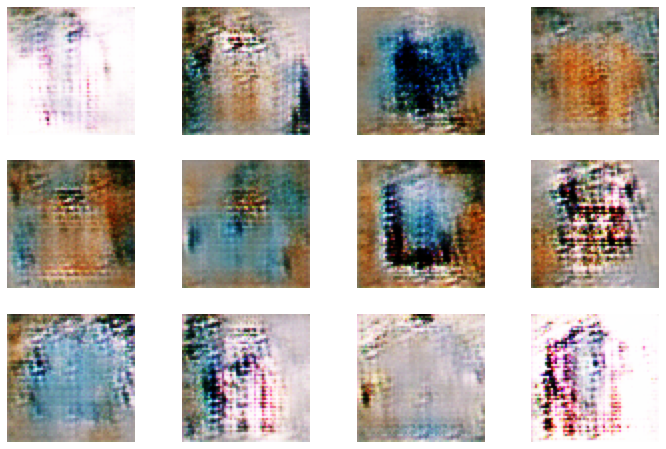

Epoch 31/200, time: 6.3815319538116455s
loss about real data: 0.10182662308216095, loss about fake data: 0.04983653128147125
loss about GAN: 3.7897121906280518

Epoch 32/200, time: 6.445341110229492s
loss about real data: 0.25335127115249634, loss about fake data: 0.1451336145401001
loss about GAN: 3.7749366760253906

Epoch 33/200, time: 6.483705759048462s
loss about real data: 0.45795977115631104, loss about fake data: 0.27280595898628235
loss about GAN: 3.722259521484375

Epoch 34/200, time: 6.32987904548645s
loss about real data: 0.2540822923183441, loss about fake data: 0.11807170510292053
loss about GAN: 4.328810214996338

Epoch 35/200, time: 6.340999126434326s
loss about real data: 0.10953862220048904, loss about fake data: 0.19353117048740387
loss about GAN: 5.442155838012695



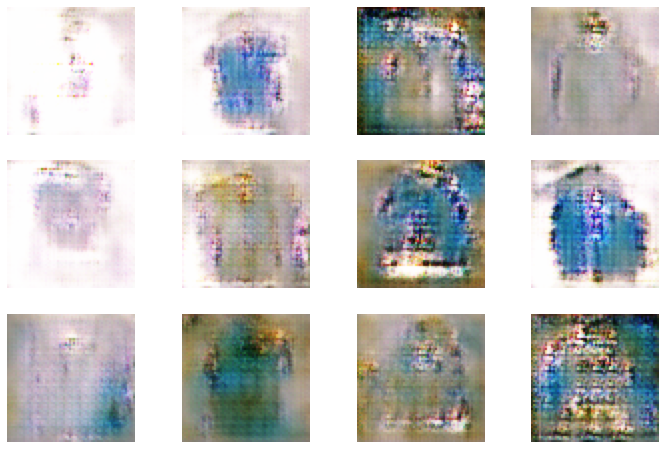

Epoch 36/200, time: 6.278553485870361s
loss about real data: 0.2204330861568451, loss about fake data: 0.1584985852241516
loss about GAN: 4.04715633392334

Epoch 37/200, time: 6.445144891738892s
loss about real data: 0.12726926803588867, loss about fake data: 0.08797069638967514
loss about GAN: 3.8605728149414062

Epoch 38/200, time: 6.444086790084839s
loss about real data: 0.4851028621196747, loss about fake data: 0.3034766614437103
loss about GAN: 4.431057453155518

Epoch 39/200, time: 6.48430323600769s
loss about real data: 0.0772521048784256, loss about fake data: 0.12552013993263245
loss about GAN: 4.576567649841309

Epoch 40/200, time: 6.351998329162598s
loss about real data: 0.16684883832931519, loss about fake data: 0.5175556540489197
loss about GAN: 4.921633720397949



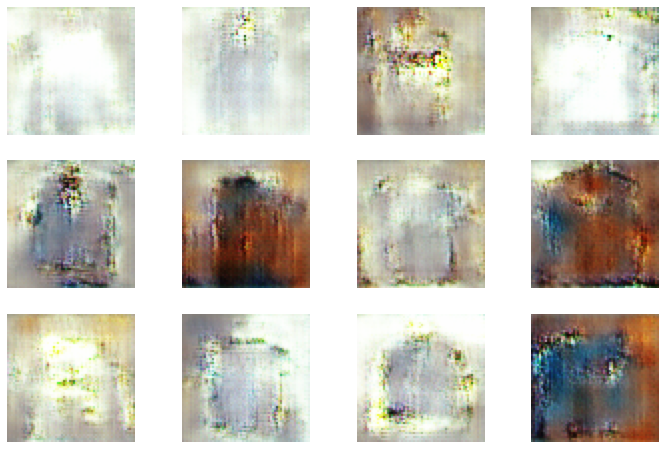

Epoch 41/200, time: 6.513405084609985s
loss about real data: 0.692659318447113, loss about fake data: 0.06474090367555618
loss about GAN: 4.225280284881592

Epoch 42/200, time: 6.390326738357544s
loss about real data: 0.16370782256126404, loss about fake data: 0.04176247864961624
loss about GAN: 4.3581318855285645

Epoch 43/200, time: 6.49391508102417s
loss about real data: 0.1951889842748642, loss about fake data: 0.050068773329257965
loss about GAN: 4.69630765914917

Epoch 44/200, time: 6.3434507846832275s
loss about real data: 0.07697132229804993, loss about fake data: 0.08999696373939514
loss about GAN: 3.6387014389038086

Epoch 45/200, time: 6.4243927001953125s
loss about real data: 0.027574332430958748, loss about fake data: 0.06587782502174377
loss about GAN: 5.026619911193848



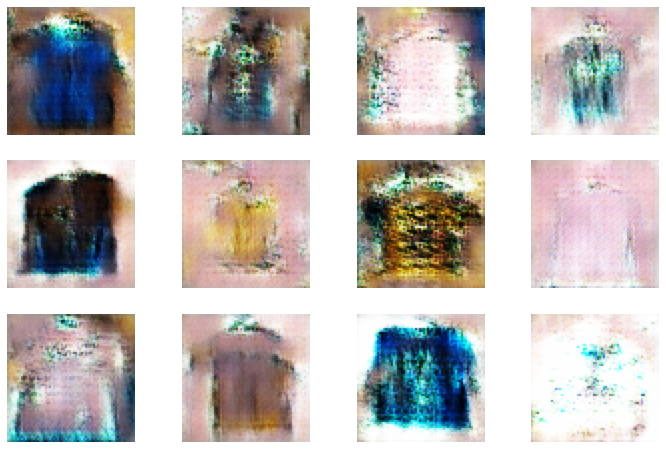

Epoch 46/200, time: 6.295161962509155s
loss about real data: 0.0253926869481802, loss about fake data: 0.16634994745254517
loss about GAN: 4.8907318115234375

Epoch 47/200, time: 6.514063358306885s
loss about real data: 0.06098535284399986, loss about fake data: 0.16685667634010315
loss about GAN: 4.161633491516113

Epoch 48/200, time: 6.414628267288208s
loss about real data: 0.18663255870342255, loss about fake data: 0.09665759652853012
loss about GAN: 4.188198089599609

Epoch 49/200, time: 6.367052316665649s
loss about real data: 0.2552620768547058, loss about fake data: 0.09019406884908676
loss about GAN: 3.9408583641052246

Epoch 50/200, time: 6.4763264656066895s
loss about real data: 0.3006443977355957, loss about fake data: 0.21489857137203217
loss about GAN: 3.674816131591797



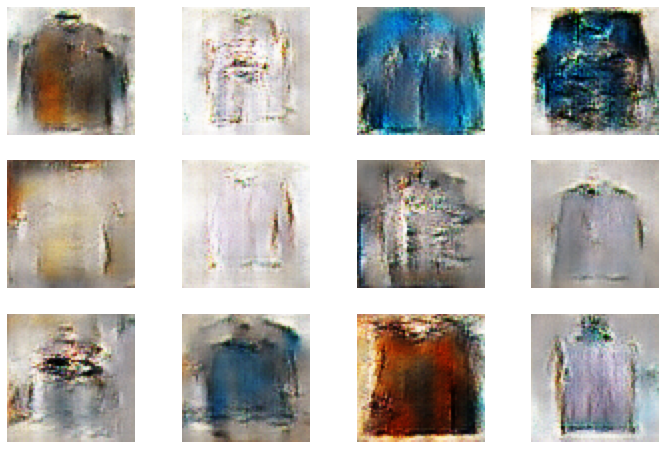

Epoch 51/200, time: 6.463160514831543s
loss about real data: 0.3977685868740082, loss about fake data: 0.3293321430683136
loss about GAN: 5.197816848754883

Epoch 52/200, time: 6.3991780281066895s
loss about real data: 0.14904455840587616, loss about fake data: 0.15970894694328308
loss about GAN: 4.000550270080566

Epoch 53/200, time: 6.5021302700042725s
loss about real data: 0.0664827898144722, loss about fake data: 0.1464112550020218
loss about GAN: 5.149945259094238

Epoch 54/200, time: 6.347931861877441s
loss about real data: 0.11740822345018387, loss about fake data: 0.05569783225655556
loss about GAN: 4.108794212341309

Epoch 55/200, time: 6.169863939285278s
loss about real data: 0.10462184250354767, loss about fake data: 0.2566748261451721
loss about GAN: 4.984976291656494



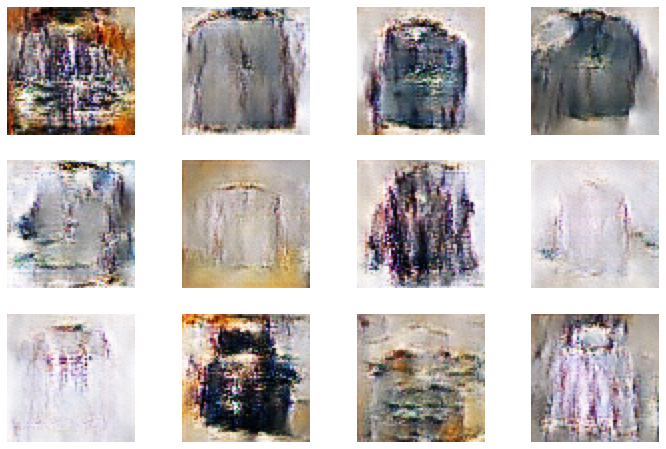

Epoch 56/200, time: 6.375823974609375s
loss about real data: 0.6914299726486206, loss about fake data: 0.10103107988834381
loss about GAN: 4.020071506500244

Epoch 57/200, time: 6.3802690505981445s
loss about real data: 0.18504470586776733, loss about fake data: 0.1940051019191742
loss about GAN: 4.064103126525879

Epoch 58/200, time: 6.441824674606323s
loss about real data: 0.2500205934047699, loss about fake data: 0.08700613677501678
loss about GAN: 7.025113105773926

Epoch 59/200, time: 6.483895778656006s
loss about real data: 0.39732757210731506, loss about fake data: 0.15899556875228882
loss about GAN: 3.710575819015503

Epoch 60/200, time: 6.385781764984131s
loss about real data: 0.17194053530693054, loss about fake data: 0.06433108448982239
loss about GAN: 4.196349143981934



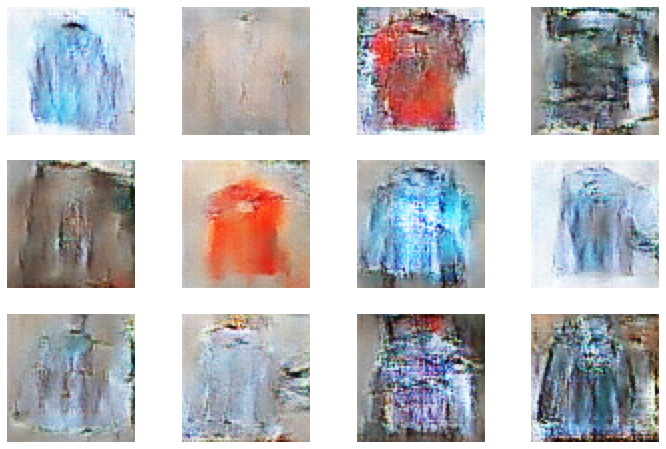

Epoch 61/200, time: 6.558119297027588s
loss about real data: 0.27549487352371216, loss about fake data: 0.10791466385126114
loss about GAN: 3.8254234790802

Epoch 62/200, time: 6.414016246795654s
loss about real data: 0.35026460886001587, loss about fake data: 0.1664886474609375
loss about GAN: 4.473386764526367

Epoch 63/200, time: 6.400229454040527s
loss about real data: 0.49075186252593994, loss about fake data: 0.27060386538505554
loss about GAN: 4.535377025604248

Epoch 64/200, time: 6.429694175720215s
loss about real data: 0.2128724306821823, loss about fake data: 0.20316959917545319
loss about GAN: 4.056761741638184

Epoch 65/200, time: 6.33911919593811s
loss about real data: 0.39315879344940186, loss about fake data: 0.20790651440620422
loss about GAN: 3.3089704513549805



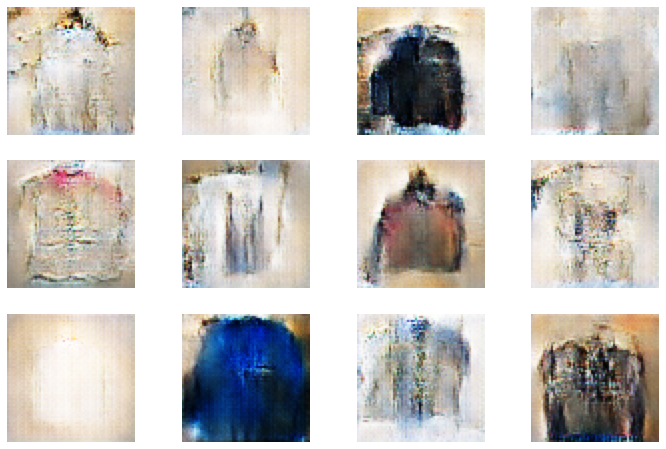

Epoch 66/200, time: 6.3698883056640625s
loss about real data: 0.23368072509765625, loss about fake data: 0.04334371164441109
loss about GAN: 4.16220760345459

Epoch 67/200, time: 6.307049989700317s
loss about real data: 0.15042725205421448, loss about fake data: 0.04475636035203934
loss about GAN: 4.253083229064941

Epoch 68/200, time: 6.434893608093262s
loss about real data: 0.0219220370054245, loss about fake data: 0.10012100636959076
loss about GAN: 4.540329933166504

Epoch 69/200, time: 6.305249929428101s
loss about real data: 0.05720093101263046, loss about fake data: 0.16141489148139954
loss about GAN: 4.813624382019043

Epoch 70/200, time: 6.5082597732543945s
loss about real data: 0.03471998870372772, loss about fake data: 0.1098746806383133
loss about GAN: 4.992576599121094



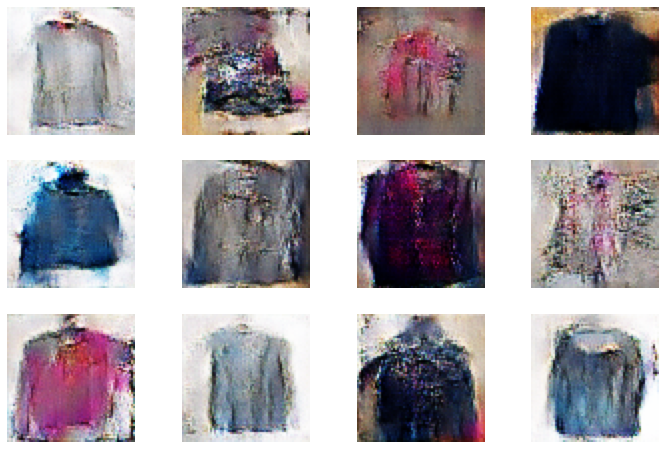

Epoch 71/200, time: 6.421790361404419s
loss about real data: 0.5470424890518188, loss about fake data: 0.10863221436738968
loss about GAN: 3.8455073833465576

Epoch 72/200, time: 6.456401586532593s
loss about real data: 0.09899627417325974, loss about fake data: 0.06024941802024841
loss about GAN: 3.9946000576019287

Epoch 73/200, time: 6.3806962966918945s
loss about real data: 0.09968802332878113, loss about fake data: 0.06666696816682816
loss about GAN: 5.295900344848633

Epoch 74/200, time: 6.4733054637908936s
loss about real data: 0.13397206366062164, loss about fake data: 0.09961477667093277
loss about GAN: 4.339880466461182

Epoch 75/200, time: 6.503822565078735s
loss about real data: 0.26258763670921326, loss about fake data: 0.23133143782615662
loss about GAN: 5.105388641357422



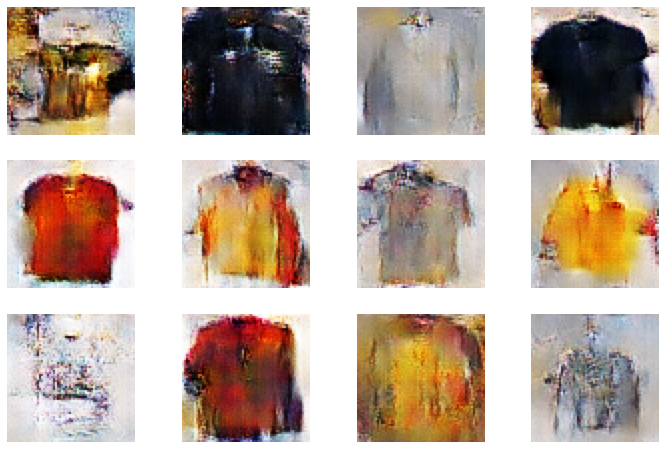

Epoch 76/200, time: 6.453516721725464s
loss about real data: 0.09882516413927078, loss about fake data: 0.18581512570381165
loss about GAN: 5.246308326721191

Epoch 77/200, time: 6.2201550006866455s
loss about real data: 0.06511858850717545, loss about fake data: 0.06120863929390907
loss about GAN: 4.828266620635986

Epoch 78/200, time: 6.3301098346710205s
loss about real data: 0.07445590943098068, loss about fake data: 0.11572728306055069
loss about GAN: 5.723897457122803

Epoch 79/200, time: 6.3751380443573s
loss about real data: 0.20001494884490967, loss about fake data: 0.07560376077890396
loss about GAN: 4.056005477905273

Epoch 80/200, time: 6.275859594345093s
loss about real data: 0.20478585362434387, loss about fake data: 0.37231743335723877
loss about GAN: 4.936705589294434



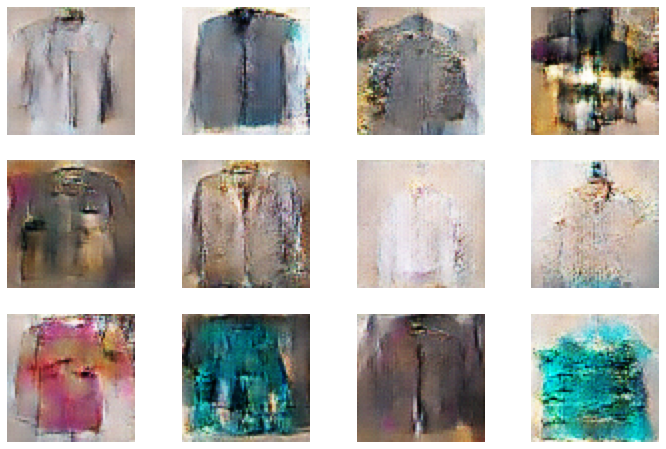

Epoch 81/200, time: 6.377250671386719s
loss about real data: 0.033467844128608704, loss about fake data: 0.3453056514263153
loss about GAN: 6.520621299743652

Epoch 82/200, time: 6.3990514278411865s
loss about real data: 0.09847059100866318, loss about fake data: 0.3078044056892395
loss about GAN: 6.283106803894043

Epoch 83/200, time: 6.25459623336792s
loss about real data: 0.14110815525054932, loss about fake data: 0.019794829189777374
loss about GAN: 6.9140448570251465

Epoch 84/200, time: 6.325889825820923s
loss about real data: 0.25632503628730774, loss about fake data: 0.07632489502429962
loss about GAN: 4.8347978591918945

Epoch 85/200, time: 6.352457046508789s
loss about real data: 0.3010227680206299, loss about fake data: 0.026680883020162582
loss about GAN: 5.5697431564331055



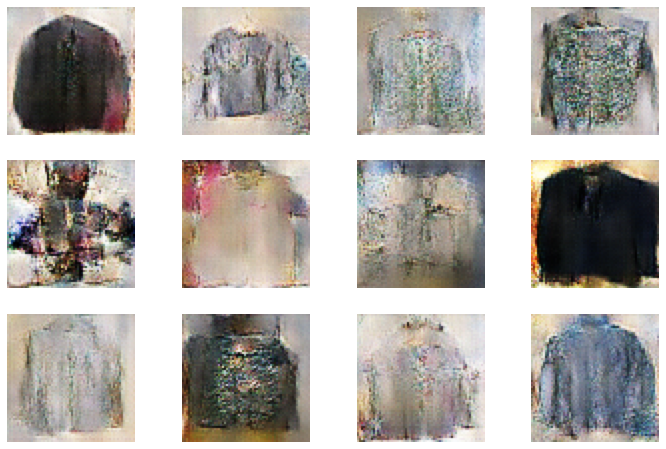

Epoch 86/200, time: 6.324969291687012s
loss about real data: 0.04522232711315155, loss about fake data: 0.027078593149781227
loss about GAN: 5.06057071685791

Epoch 87/200, time: 6.243920564651489s
loss about real data: 0.16317927837371826, loss about fake data: 0.01912541314959526
loss about GAN: 4.3070597648620605

Epoch 88/200, time: 6.408957004547119s
loss about real data: 0.016344835981726646, loss about fake data: 0.1629193276166916
loss about GAN: 6.067559719085693

Epoch 89/200, time: 6.306717157363892s
loss about real data: 0.016575271263718605, loss about fake data: 0.12223336100578308
loss about GAN: 6.902785301208496

Epoch 90/200, time: 6.353799343109131s
loss about real data: 0.048208318650722504, loss about fake data: 0.034195009618997574
loss about GAN: 5.135149002075195



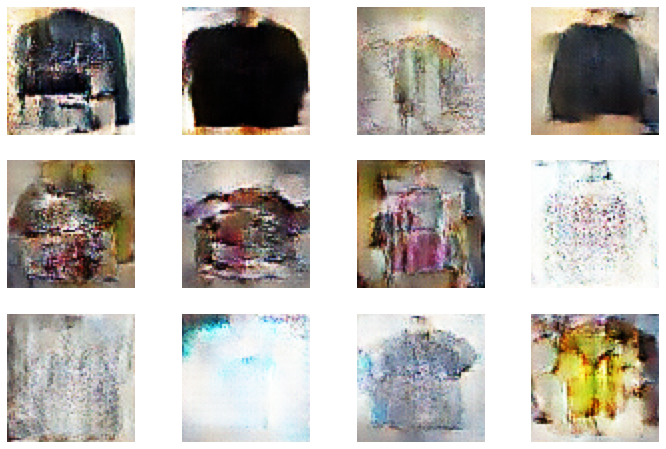

Epoch 91/200, time: 6.250087022781372s
loss about real data: 0.08048132061958313, loss about fake data: 0.12528225779533386
loss about GAN: 4.412282466888428

Epoch 92/200, time: 6.385844945907593s
loss about real data: 0.06058346480131149, loss about fake data: 0.1993347704410553
loss about GAN: 5.817598342895508

Epoch 93/200, time: 6.332117557525635s
loss about real data: 0.0338275246322155, loss about fake data: 0.06311444193124771
loss about GAN: 6.616519927978516

Epoch 94/200, time: 6.297142028808594s
loss about real data: 0.2571481466293335, loss about fake data: 0.3644123375415802
loss about GAN: 4.350769996643066

Epoch 95/200, time: 6.366859197616577s
loss about real data: 0.024825718253850937, loss about fake data: 0.1667337417602539
loss about GAN: 5.456761837005615



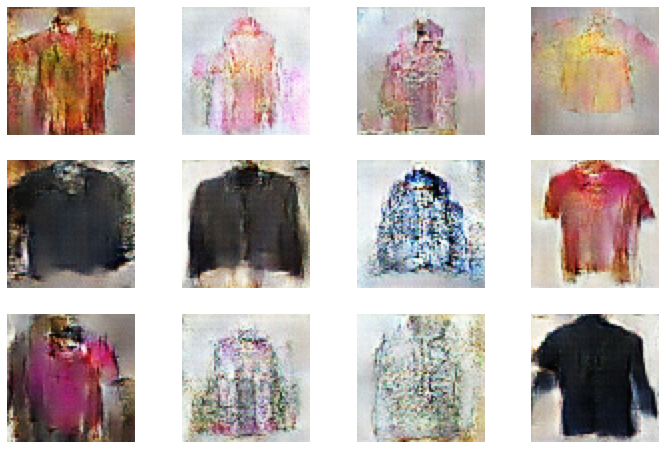

Epoch 96/200, time: 6.275088548660278s
loss about real data: 0.2756992280483246, loss about fake data: 0.15057866275310516
loss about GAN: 4.689043998718262

Epoch 97/200, time: 6.327832221984863s
loss about real data: 0.13934704661369324, loss about fake data: 0.05143040791153908
loss about GAN: 5.499141693115234

Epoch 98/200, time: 6.385422468185425s
loss about real data: 0.09870927035808563, loss about fake data: 0.21300572156906128
loss about GAN: 5.269572734832764

Epoch 99/200, time: 6.354093074798584s
loss about real data: 0.08747178316116333, loss about fake data: 0.1518712043762207
loss about GAN: 3.7973241806030273

Epoch 100/200, time: 6.345409393310547s
loss about real data: 0.05755015090107918, loss about fake data: 0.02304074540734291
loss about GAN: 4.383096694946289



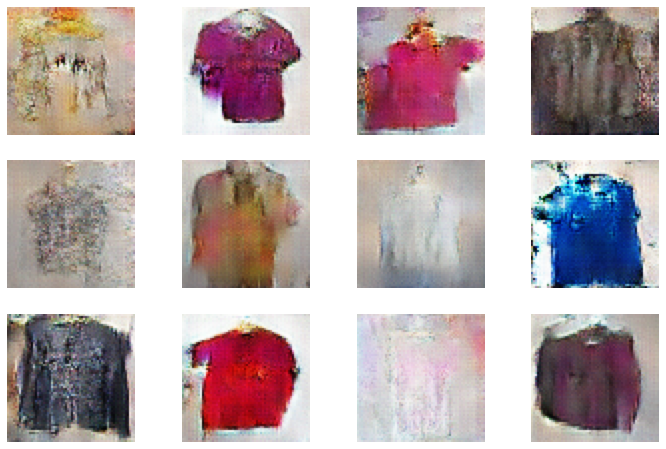

Epoch 101/200, time: 6.32936429977417s
loss about real data: 0.03070080280303955, loss about fake data: 0.07847639173269272
loss about GAN: 6.579012393951416

Epoch 102/200, time: 6.26944637298584s
loss about real data: 0.029686082154512405, loss about fake data: 0.2356647253036499
loss about GAN: 6.843715667724609

Epoch 103/200, time: 6.33286452293396s
loss about real data: 0.01452269684523344, loss about fake data: 0.19744589924812317
loss about GAN: 6.77694845199585

Epoch 104/200, time: 6.248467683792114s
loss about real data: 0.07128194719552994, loss about fake data: 0.07709269225597382
loss about GAN: 5.17919921875

Epoch 105/200, time: 6.237832546234131s
loss about real data: 0.03171415627002716, loss about fake data: 0.06759906560182571
loss about GAN: 5.583713531494141



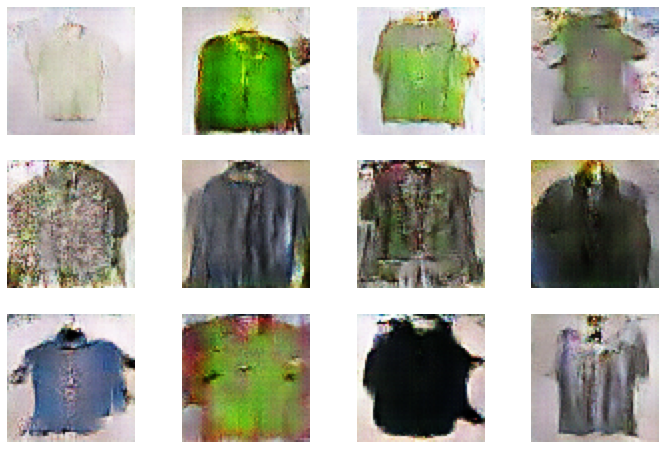

Epoch 106/200, time: 6.3851072788238525s
loss about real data: 0.1346939206123352, loss about fake data: 0.04815623164176941
loss about GAN: 5.709897994995117

Epoch 107/200, time: 6.385012149810791s
loss about real data: 0.07880054414272308, loss about fake data: 0.046152450144290924
loss about GAN: 5.903838157653809

Epoch 108/200, time: 6.229604959487915s
loss about real data: 0.04506058245897293, loss about fake data: 0.015985123813152313
loss about GAN: 6.8104329109191895

Epoch 109/200, time: 6.4231884479522705s
loss about real data: 0.2753292918205261, loss about fake data: 0.04043564572930336
loss about GAN: 5.581211090087891

Epoch 110/200, time: 6.248017072677612s
loss about real data: 0.037142444401979446, loss about fake data: 0.21005597710609436
loss about GAN: 6.276177406311035



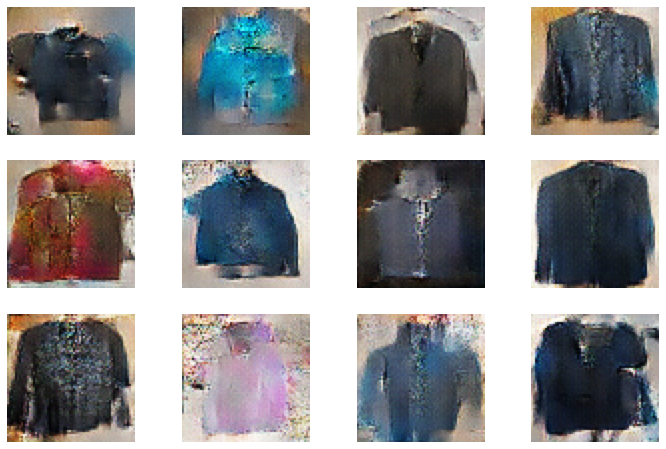

Epoch 111/200, time: 6.415997743606567s
loss about real data: 0.03576287627220154, loss about fake data: 0.1006699725985527
loss about GAN: 5.352590084075928

Epoch 112/200, time: 6.342261075973511s
loss about real data: 0.029104650020599365, loss about fake data: 0.05339032784104347
loss about GAN: 6.09672737121582

Epoch 113/200, time: 6.281002759933472s
loss about real data: 0.09531863778829575, loss about fake data: 0.5787705183029175
loss about GAN: 5.913908958435059

Epoch 114/200, time: 6.3569276332855225s
loss about real data: 0.11636067926883698, loss about fake data: 0.03227680176496506
loss about GAN: 4.9041547775268555

Epoch 115/200, time: 6.26421046257019s
loss about real data: 0.016507621854543686, loss about fake data: 0.8704237937927246
loss about GAN: 6.043909549713135



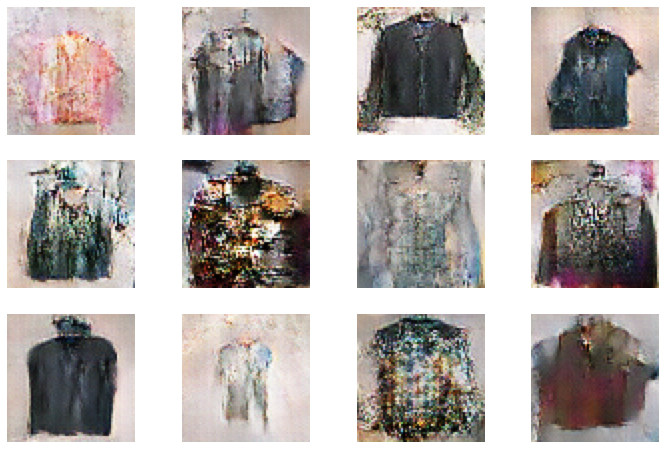

Epoch 116/200, time: 6.437619209289551s
loss about real data: 0.22160719335079193, loss about fake data: 0.026649869978427887
loss about GAN: 6.189821243286133

Epoch 117/200, time: 6.474771738052368s
loss about real data: 0.01441945694386959, loss about fake data: 0.15176892280578613
loss about GAN: 7.322391510009766

Epoch 118/200, time: 6.267724514007568s
loss about real data: 0.14798413217067719, loss about fake data: 0.09366516023874283
loss about GAN: 7.788060665130615

Epoch 119/200, time: 6.387911081314087s
loss about real data: 0.051490455865859985, loss about fake data: 0.011148770339787006
loss about GAN: 7.160658836364746

Epoch 120/200, time: 6.322771310806274s
loss about real data: 0.1669217348098755, loss about fake data: 0.011508575640618801
loss about GAN: 5.056329727172852



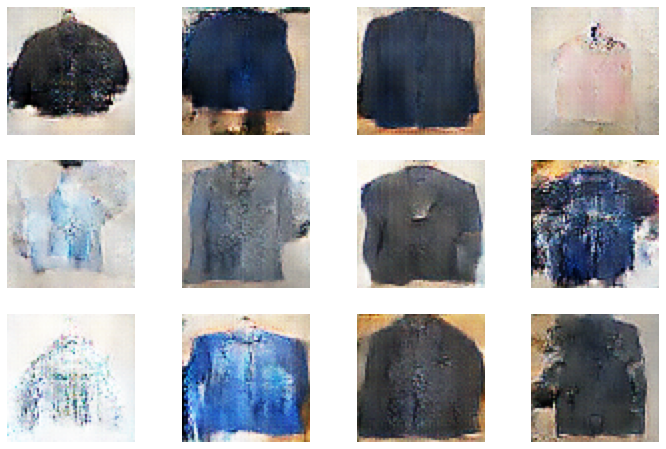

Epoch 121/200, time: 6.304707765579224s
loss about real data: 0.2236950695514679, loss about fake data: 0.12024842947721481
loss about GAN: 5.5867695808410645

Epoch 122/200, time: 6.25290322303772s
loss about real data: 0.08597399294376373, loss about fake data: 0.03628033399581909
loss about GAN: 7.001011371612549

Epoch 123/200, time: 6.2736804485321045s
loss about real data: 0.05708196014165878, loss about fake data: 0.04365013539791107
loss about GAN: 5.939528465270996

Epoch 124/200, time: 6.309735298156738s
loss about real data: 0.07509112358093262, loss about fake data: 0.047333456575870514
loss about GAN: 6.262279987335205

Epoch 125/200, time: 6.291711330413818s
loss about real data: 0.025102023035287857, loss about fake data: 0.13611894845962524
loss about GAN: 6.849170207977295



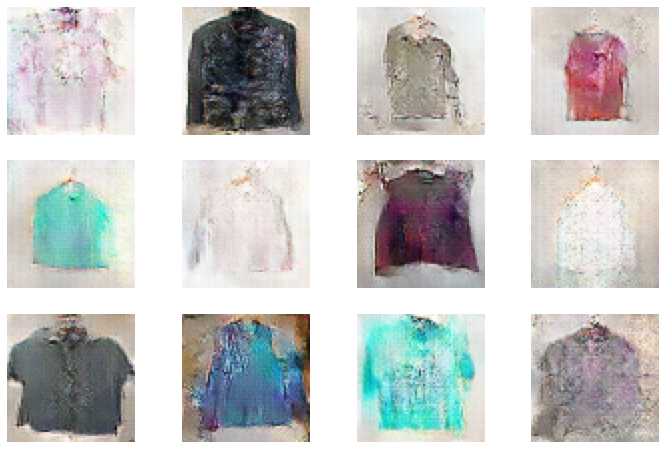

Epoch 126/200, time: 6.2873921394348145s
loss about real data: 0.10391411185264587, loss about fake data: 0.3250579237937927
loss about GAN: 6.537755012512207

Epoch 127/200, time: 6.231897592544556s
loss about real data: 0.00961296632885933, loss about fake data: 0.09355361014604568
loss about GAN: 6.11917781829834

Epoch 128/200, time: 6.223998069763184s
loss about real data: 0.03470178321003914, loss about fake data: 0.27423906326293945
loss about GAN: 6.657426357269287

Epoch 129/200, time: 6.358541488647461s
loss about real data: 0.04364139586687088, loss about fake data: 0.049813926219940186
loss about GAN: 6.156115531921387

Epoch 130/200, time: 6.263413190841675s
loss about real data: 0.03595593944191933, loss about fake data: 0.17135891318321228
loss about GAN: 6.58234977722168



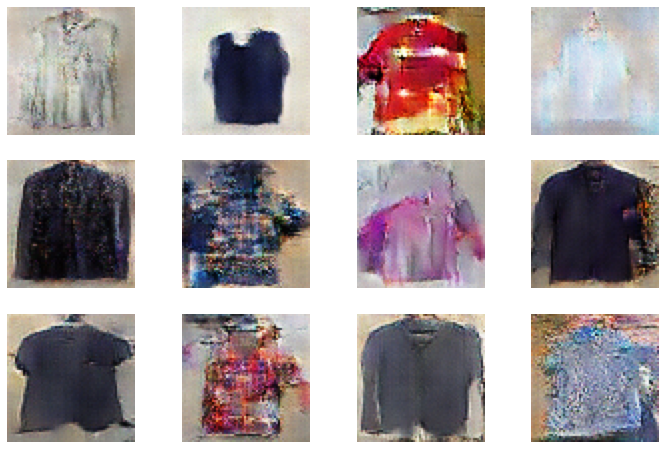

Epoch 131/200, time: 6.370634317398071s
loss about real data: 0.3759676218032837, loss about fake data: 0.13181434571743011
loss about GAN: 5.066400527954102

Epoch 132/200, time: 6.315962076187134s
loss about real data: 0.026261378079652786, loss about fake data: 0.011620793491601944
loss about GAN: 5.902045249938965

Epoch 133/200, time: 6.437995433807373s
loss about real data: 0.004641624633222818, loss about fake data: 0.2574678957462311
loss about GAN: 6.080935478210449

Epoch 134/200, time: 6.284156084060669s
loss about real data: 0.2503052055835724, loss about fake data: 0.10234227031469345
loss about GAN: 5.947571754455566

Epoch 135/200, time: 6.438781499862671s
loss about real data: 0.015393378213047981, loss about fake data: 0.04766497761011124
loss about GAN: 5.944258689880371



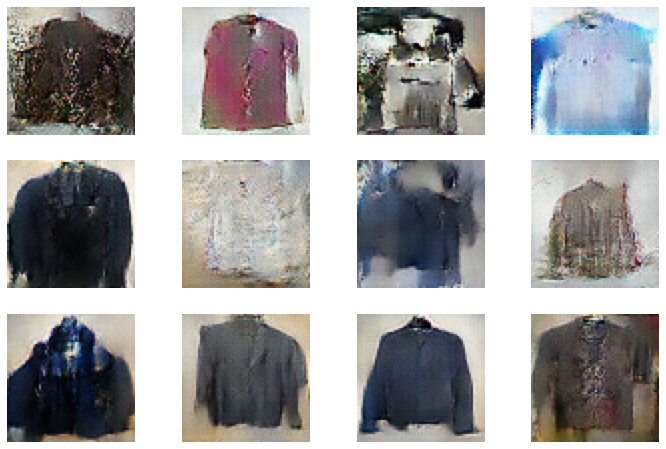

Epoch 136/200, time: 6.330852270126343s
loss about real data: 0.30235040187835693, loss about fake data: 0.06040258705615997
loss about GAN: 5.595052719116211

Epoch 137/200, time: 6.252847671508789s
loss about real data: 0.03719005361199379, loss about fake data: 0.13520391285419464
loss about GAN: 7.310619354248047

Epoch 138/200, time: 6.44080114364624s
loss about real data: 0.07567453384399414, loss about fake data: 0.12338604032993317
loss about GAN: 6.880678653717041

Epoch 139/200, time: 6.464709520339966s
loss about real data: 0.029414404183626175, loss about fake data: 0.02080373838543892
loss about GAN: 7.281221866607666

Epoch 140/200, time: 6.228684663772583s
loss about real data: 0.1418347805738449, loss about fake data: 0.11224095523357391
loss about GAN: 6.340686798095703



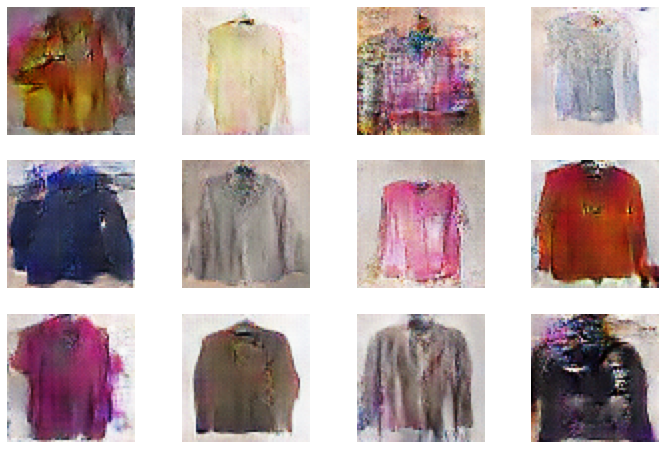

Epoch 141/200, time: 6.3967125415802s
loss about real data: 0.02094726637005806, loss about fake data: 0.10385812819004059
loss about GAN: 6.6855621337890625

Epoch 142/200, time: 6.2380876541137695s
loss about real data: 0.01363456156104803, loss about fake data: 0.06083892285823822
loss about GAN: 5.5728654861450195

Epoch 143/200, time: 6.338449001312256s
loss about real data: 0.028391461819410324, loss about fake data: 0.039835818111896515
loss about GAN: 6.311352252960205

Epoch 144/200, time: 6.24593186378479s
loss about real data: 0.1780397891998291, loss about fake data: 0.1154027134180069
loss about GAN: 6.223957061767578

Epoch 145/200, time: 6.337544679641724s
loss about real data: 0.09264758974313736, loss about fake data: 0.09525004029273987
loss about GAN: 6.380541801452637



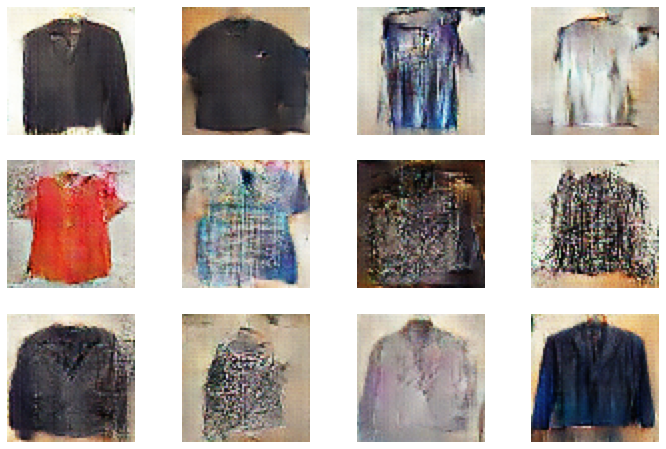

Epoch 146/200, time: 6.396489381790161s
loss about real data: 0.06264244765043259, loss about fake data: 0.1170007660984993
loss about GAN: 6.514782905578613

Epoch 147/200, time: 6.451878547668457s
loss about real data: 0.02241184562444687, loss about fake data: 0.04490950331091881
loss about GAN: 7.638545989990234

Epoch 148/200, time: 6.338441371917725s
loss about real data: 0.620673418045044, loss about fake data: 0.2811945974826813
loss about GAN: 6.861738204956055

Epoch 149/200, time: 6.480961561203003s
loss about real data: 0.17466162145137787, loss about fake data: 0.12148487567901611
loss about GAN: 6.514883041381836

Epoch 150/200, time: 6.481769561767578s
loss about real data: 0.0315985232591629, loss about fake data: 0.0609092116355896
loss about GAN: 8.55085563659668



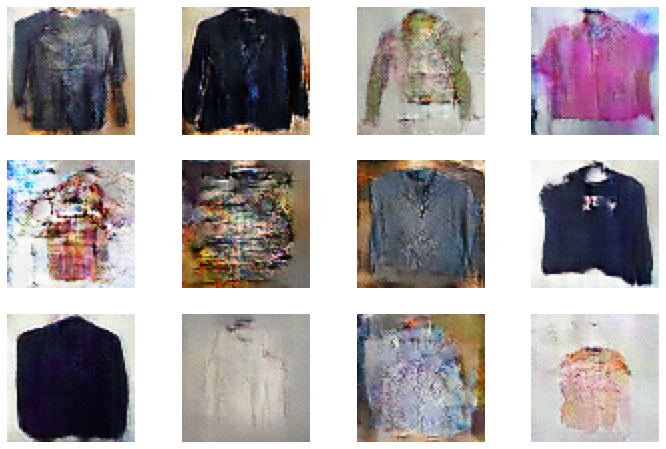

Epoch 151/200, time: 6.370548725128174s
loss about real data: 0.032550279051065445, loss about fake data: 0.0944254919886589
loss about GAN: 7.94199275970459

Epoch 152/200, time: 6.47589635848999s
loss about real data: 0.10503259301185608, loss about fake data: 0.10041964054107666
loss about GAN: 8.64719009399414

Epoch 153/200, time: 6.52830171585083s
loss about real data: 0.023633519187569618, loss about fake data: 0.1560581475496292
loss about GAN: 5.999919891357422

Epoch 154/200, time: 6.601128578186035s
loss about real data: 0.12937091290950775, loss about fake data: 0.02258548140525818
loss about GAN: 5.252649307250977

Epoch 155/200, time: 6.452838659286499s
loss about real data: 0.02506937086582184, loss about fake data: 0.06839998811483383
loss about GAN: 7.814998626708984



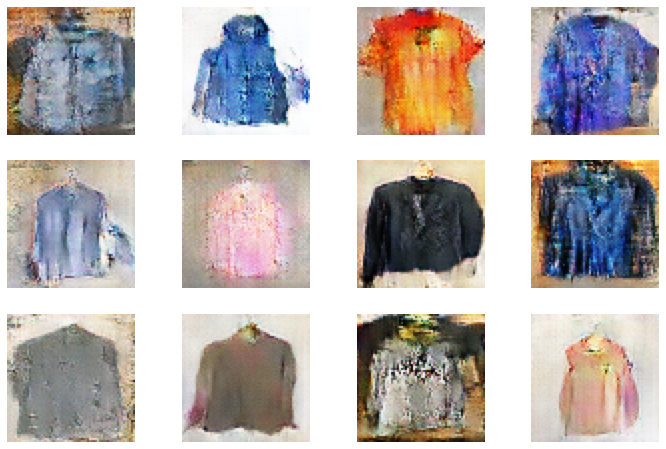

Epoch 156/200, time: 6.579596519470215s
loss about real data: 0.06525532901287079, loss about fake data: 0.16573289036750793
loss about GAN: 8.99585247039795

Epoch 157/200, time: 6.390255451202393s
loss about real data: 0.10989458113908768, loss about fake data: 0.006028916221112013
loss about GAN: 9.476022720336914

Epoch 158/200, time: 6.5462000370025635s
loss about real data: 0.011763686314225197, loss about fake data: 0.08498167246580124
loss about GAN: 6.52004337310791

Epoch 159/200, time: 6.300631523132324s
loss about real data: 0.12911146879196167, loss about fake data: 0.013491684570908546
loss about GAN: 7.227495193481445

Epoch 160/200, time: 6.437889575958252s
loss about real data: 0.046932220458984375, loss about fake data: 0.08217446506023407
loss about GAN: 6.952587604522705



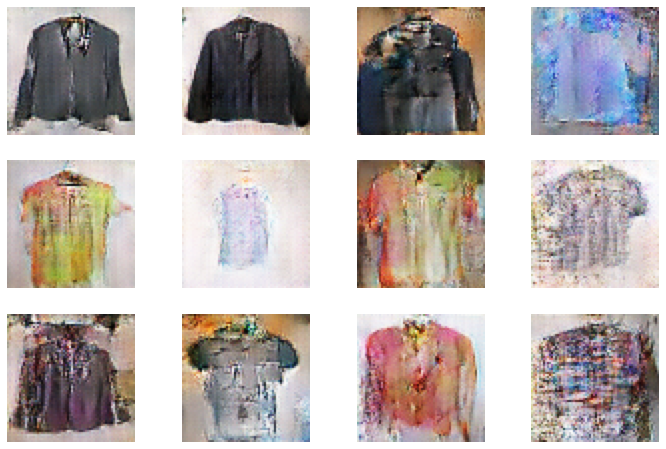

Epoch 161/200, time: 6.23866605758667s
loss about real data: 0.022645164281129837, loss about fake data: 0.1217883974313736
loss about GAN: 8.158204078674316

Epoch 162/200, time: 6.342888832092285s
loss about real data: 0.0691804438829422, loss about fake data: 0.10401426255702972
loss about GAN: 7.37864875793457

Epoch 163/200, time: 6.4088873863220215s
loss about real data: 0.16118814051151276, loss about fake data: 0.1309996098279953
loss about GAN: 6.56991720199585

Epoch 164/200, time: 6.2419397830963135s
loss about real data: 0.08674440532922745, loss about fake data: 0.03482536971569061
loss about GAN: 7.081386566162109

Epoch 165/200, time: 6.2719433307647705s
loss about real data: 0.05455334484577179, loss about fake data: 0.015099328011274338
loss about GAN: 6.427096366882324



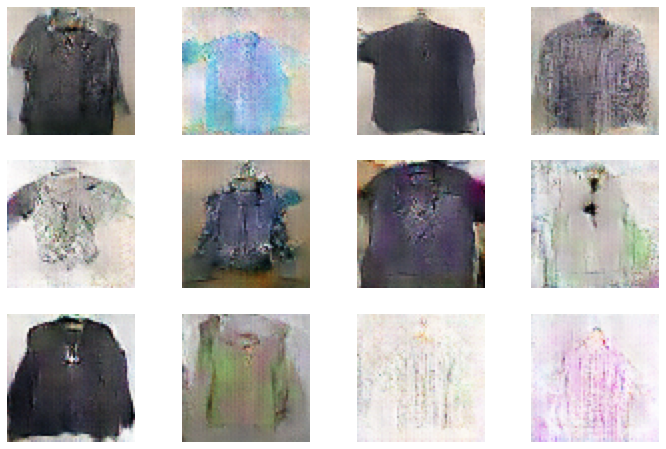

Epoch 166/200, time: 6.236162185668945s
loss about real data: 0.006758331321179867, loss about fake data: 0.22750797867774963
loss about GAN: 7.525608062744141

Epoch 167/200, time: 6.239376783370972s
loss about real data: 0.05395068973302841, loss about fake data: 0.011991884559392929
loss about GAN: 8.537426948547363

Epoch 168/200, time: 6.382093667984009s
loss about real data: 0.012366964481770992, loss about fake data: 0.0614142045378685
loss about GAN: 7.275906562805176

Epoch 169/200, time: 6.263714551925659s
loss about real data: 0.05252664163708687, loss about fake data: 0.013747699558734894
loss about GAN: 6.808962345123291

Epoch 170/200, time: 6.218207120895386s
loss about real data: 0.0023320401087403297, loss about fake data: 0.03301422297954559
loss about GAN: 6.329948425292969



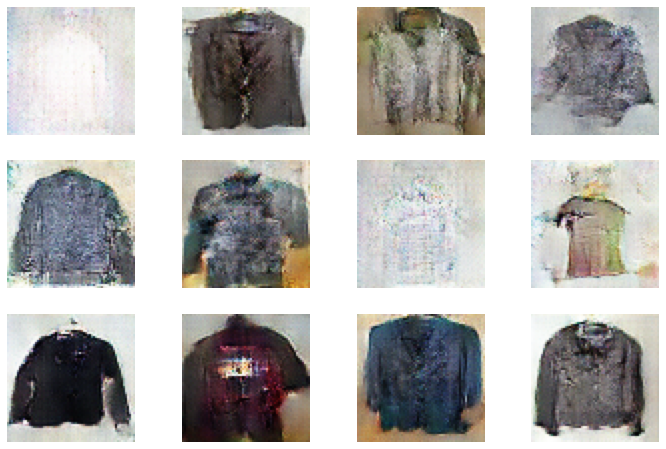

Epoch 171/200, time: 6.282219648361206s
loss about real data: 0.01880849525332451, loss about fake data: 0.06995897740125656
loss about GAN: 6.90435791015625

Epoch 172/200, time: 6.381407976150513s
loss about real data: 0.14756859838962555, loss about fake data: 0.053151436150074005
loss about GAN: 7.203158378601074

Epoch 173/200, time: 6.244543552398682s
loss about real data: 0.47921374440193176, loss about fake data: 0.012980954721570015
loss about GAN: 6.768569469451904

Epoch 174/200, time: 6.20707106590271s
loss about real data: 0.01477106474339962, loss about fake data: 0.47881177067756653
loss about GAN: 9.968157768249512

Epoch 175/200, time: 6.336118698120117s
loss about real data: 0.07770103216171265, loss about fake data: 0.20848998427391052
loss about GAN: 8.509414672851562



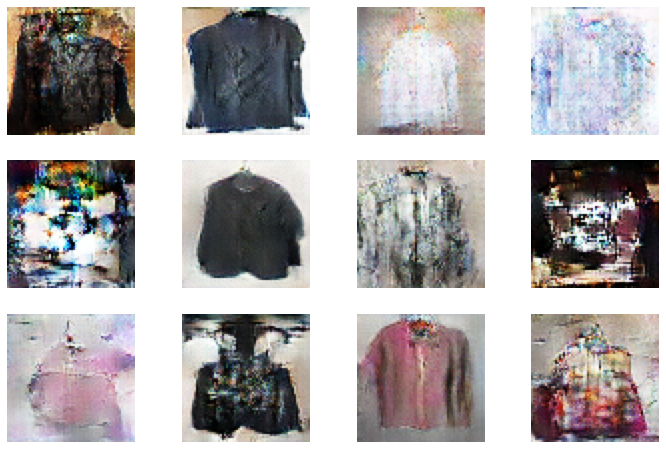

Epoch 176/200, time: 6.127216577529907s
loss about real data: 0.022701315581798553, loss about fake data: 0.1323404610157013
loss about GAN: 8.595894813537598

Epoch 177/200, time: 6.392432451248169s
loss about real data: 0.01116558350622654, loss about fake data: 0.17057353258132935
loss about GAN: 7.671443939208984

Epoch 178/200, time: 6.262984752655029s
loss about real data: 0.17607000470161438, loss about fake data: 0.04269438236951828
loss about GAN: 6.4335174560546875

Epoch 179/200, time: 6.1595258712768555s
loss about real data: 0.1596512794494629, loss about fake data: 0.010168733075261116
loss about GAN: 5.106725692749023

Epoch 180/200, time: 6.201702117919922s
loss about real data: 0.005979304667562246, loss about fake data: 0.01879112422466278
loss about GAN: 7.403977394104004



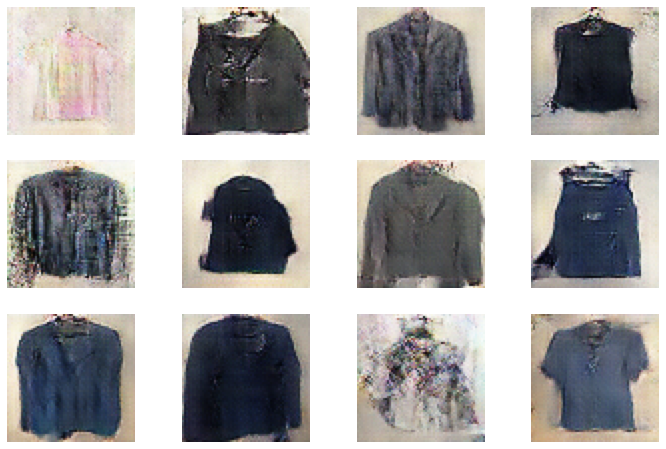

Epoch 181/200, time: 6.447223901748657s
loss about real data: 0.012169423513114452, loss about fake data: 0.3342236280441284
loss about GAN: 7.984030723571777

Epoch 182/200, time: 6.438348054885864s
loss about real data: 0.023161010816693306, loss about fake data: 0.1932155340909958
loss about GAN: 9.799077033996582

Epoch 183/200, time: 6.218209743499756s
loss about real data: 0.07141467183828354, loss about fake data: 0.01675499603152275
loss about GAN: 7.116126537322998

Epoch 184/200, time: 6.359784364700317s
loss about real data: 0.007285475730895996, loss about fake data: 0.06552932411432266
loss about GAN: 6.99752140045166

Epoch 185/200, time: 6.198939561843872s
loss about real data: 0.023581698536872864, loss about fake data: 0.04205654561519623
loss about GAN: 6.448938369750977



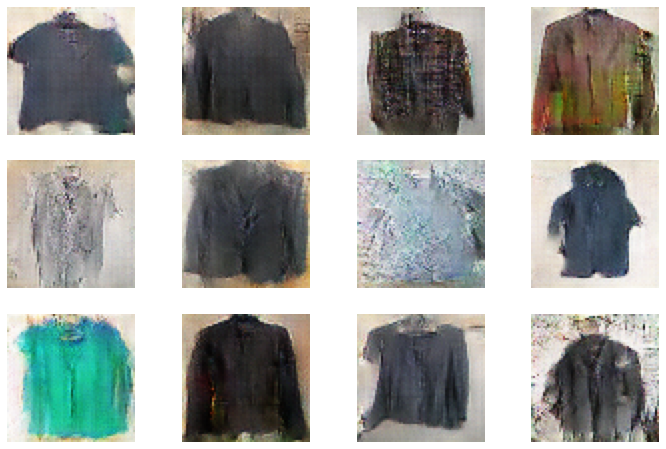

Epoch 186/200, time: 6.243116617202759s
loss about real data: 0.049694426357746124, loss about fake data: 0.15022486448287964
loss about GAN: 8.301973342895508

Epoch 187/200, time: 6.212718725204468s
loss about real data: 0.013448946177959442, loss about fake data: 0.014200350269675255
loss about GAN: 8.312094688415527

Epoch 188/200, time: 6.295274257659912s
loss about real data: 0.04180226847529411, loss about fake data: 0.16115827858448029
loss about GAN: 7.11850118637085

Epoch 189/200, time: 6.238642692565918s
loss about real data: 0.015164095908403397, loss about fake data: 0.09263403713703156
loss about GAN: 8.711336135864258

Epoch 190/200, time: 6.295940637588501s
loss about real data: 0.30267173051834106, loss about fake data: 0.03793466091156006
loss about GAN: 5.803455829620361



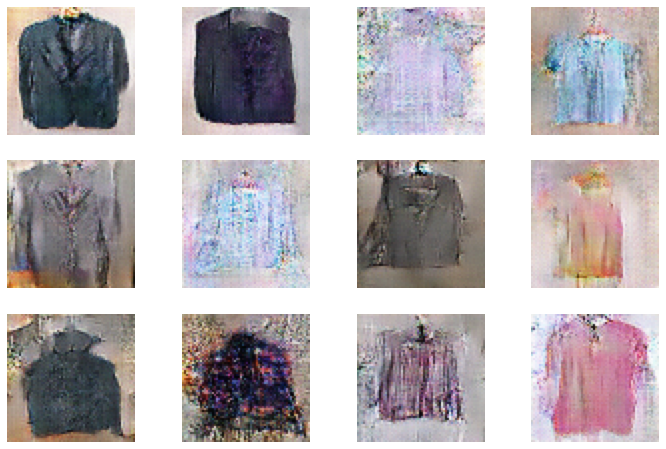

Epoch 191/200, time: 6.192065954208374s
loss about real data: 0.0018744455883279443, loss about fake data: 0.02873682603240013
loss about GAN: 9.838163375854492

Epoch 192/200, time: 6.206177473068237s
loss about real data: 0.0824991837143898, loss about fake data: 0.016939258202910423
loss about GAN: 6.398155212402344

Epoch 193/200, time: 6.224219799041748s
loss about real data: 0.01820928417146206, loss about fake data: 0.008659439161419868
loss about GAN: 7.181452751159668

Epoch 194/200, time: 6.348035097122192s
loss about real data: 0.09174490720033646, loss about fake data: 0.16735495626926422
loss about GAN: 7.65573263168335

Epoch 195/200, time: 6.2201173305511475s
loss about real data: 0.11048589646816254, loss about fake data: 0.019353825598955154
loss about GAN: 10.503111839294434



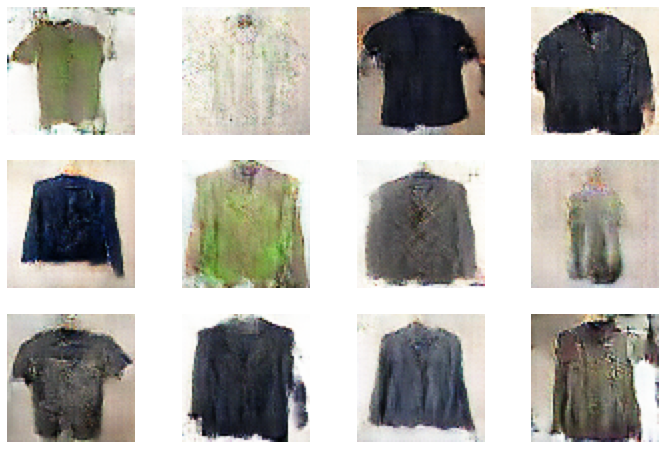

Epoch 196/200, time: 6.335959434509277s
loss about real data: 0.3787032663822174, loss about fake data: 0.15950605273246765
loss about GAN: 7.448239326477051

Epoch 197/200, time: 6.273229122161865s
loss about real data: 0.017031434923410416, loss about fake data: 0.19017791748046875
loss about GAN: 7.831018447875977

Epoch 198/200, time: 6.279738187789917s
loss about real data: 0.0767507329583168, loss about fake data: 0.2803291380405426
loss about GAN: 7.770240783691406

Epoch 199/200, time: 6.245388507843018s
loss about real data: 0.18204113841056824, loss about fake data: 0.04286125302314758
loss about GAN: 8.059710502624512

Epoch 200/200, time: 6.263189315795898s
loss about real data: 0.4454478621482849, loss about fake data: 0.00806746631860733
loss about GAN: 7.007172584533691



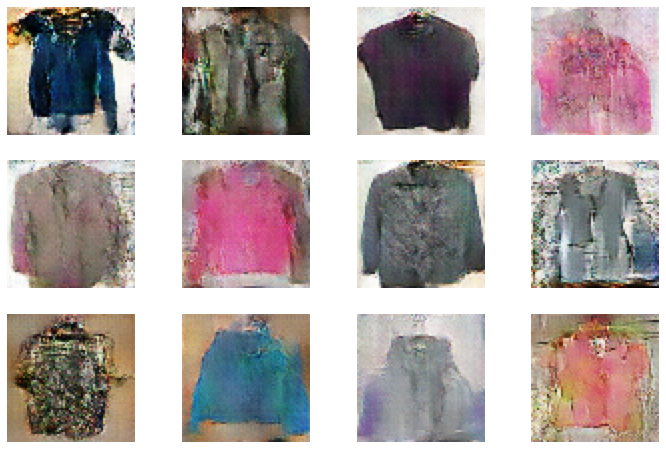

Total time for training is 1288.8531827926636s


In [15]:
# set epochs number
EPOCH = 200

# model training
generated_images = train_gan(gan, 
                             dataset, 
                             batch_size=batch_size, 
                             latent_dim=latent_dim, 
                             n_epochs=EPOCH,
                             show_image_epoch=5)

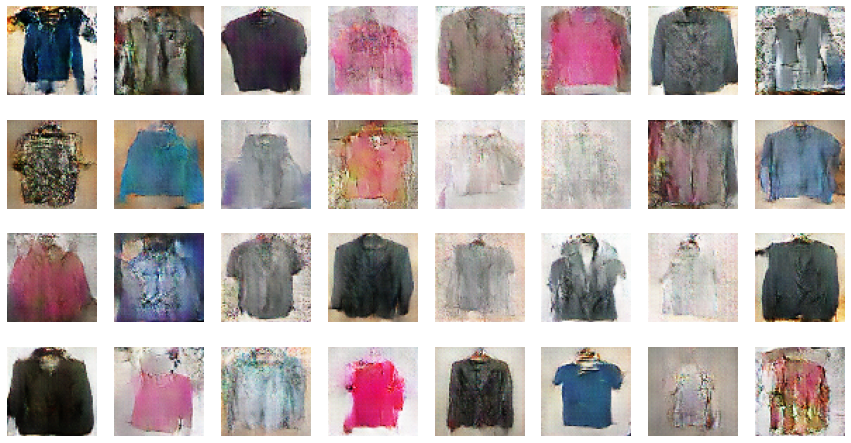

In [16]:
# show result of generated images activaion
plt.figure(figsize=(15,8))
for i in range(32):
    plt.subplot(4,8,i+1)
    img = (generated_images[i]+1)/2
    plt.imshow(img)
    plt.axis('off')
plt.show()